# EE655 - Course Project

## Pimple Removal using UNet CNN

### Mounting Google Drive

Note that this is requi

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


### Setting up Dependencies

In [ ]:
!pip install face-alignment
!pip install alphashape
!pip install descartes
!pip install xmltodict

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 1.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 26.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 24.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 32.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 5.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 16.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 7.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 4.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 67.7 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.5.82
    Uninstalling nvidia-nvjitlink-cu12-12.5.82:
      Successfully uninstalled nvidia-nvjitlin

Importing all libraries required in the project

In [ ]:
import alphashape
import torch
import numpy as np
from copy import copy
import matplotlib.pyplot as plt
import dlib
import alphashape
from shapely.geometry import MultiPoint
import itertools
import shutil
import cv2
from google.colab.patches import cv2_imshow
import os
import sys
import face_alignment
from skimage import io
from sklearn.metrics.pairwise import euclidean_distances
from scipy.optimize import minimize

### 1. Downloading dataset

In [ ]:
DEVICE = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print('DEVICE:', DEVICE)

DEVICE: cpu



The dataset below is used for comparison of the two Acne Detection methods used later in the pipeline architecture

In [ ]:
data_path = f'/content/drive/MyDrive/Final-Project/final_dataset.zip'
!unzip -o {data_path}

Archive:  /content/drive/MyDrive/Final-Project/final_dataset.zip
   creating: final_dataset/
   creating: final_dataset/images/
  inflating: final_dataset/images/t1.jpg  
  inflating: final_dataset/images/t10.jpg  
  inflating: final_dataset/images/t11.png  
  inflating: final_dataset/images/t12.png  
  inflating: final_dataset/images/t13.jpg  
  inflating: final_dataset/images/t14.png  
  inflating: final_dataset/images/t15.png  
  inflating: final_dataset/images/t16.png  
  inflating: final_dataset/images/t17.jpg  
  inflating: final_dataset/images/t18.png  
  inflating: final_dataset/images/t19.png  
  inflating: final_dataset/images/t2.jpg  
  inflating: final_dataset/images/t20.png  
  inflating: final_dataset/images/t21.png  
  inflating: final_dataset/images/t22.png  
  inflating: final_dataset/images/t23.jpg  
  inflating: final_dataset/images/t24.jpg  
  inflating: final_dataset/images/t25.jpg  
  inflating: final_dataset/images/t26.jpg  
  inflating: final_dataset/images/t27.

This is a pre-defined model for identifing 68 facial landmarks used in the project

In [ ]:
data_path = '/content/drive/MyDrive/Final-Project/shape_predictor_68_face_landmarks.dat'
shutil.copy(data_path, '/content/')

'/content/shape_predictor_68_face_landmarks.dat'

### 2. Helper Functions

Function to calculate the recall score for a set of predictions and ground truth masks.

In [ ]:
def calculate_recall(prediction, ground_truth):
    n_images = len(prediction)
    intersection = 0
    true_positives = 0
    for i in range(n_images):
        logical_and = np.logical_and(prediction[i] > 0, ground_truth[i] > 0)
        intersection += logical_and.astype(np.float32).sum()
        true_positives += (ground_truth[i] > 0).astype(np.float32).sum()
    return float(intersection) / true_positives


Function to plot image

In [ ]:
def plot_img(img, cmap='gray'):
    plt.figure(dpi = 300)
    plt.imshow(img, cmap=cmap)
    plt.axis('off')
    plt.show()

Function to calculate the slope, equation of a line, and euclidean distance
of the two points

In [ ]:
def line_from_points(point1, point2):
  x1, y1 = point1
  x2, y2 = point2
  m = (y1-y2)/(x1-x2+ 1e-4)
  b = y1 - m*x1
  d = euclidean_distances(point1.reshape(1,2), point2.reshape(1,2))[0][0]
  return m, b, d

Function to find the intersection point of two lines given their slopes and y-intercepts

In [ ]:
def find_intersection(m1, c1, m2, c2):
    x = (c2-c1)/(m1-m2)
    y = m1*x+c1
    return np.array([x, y]).astype(int)

Function to calculate point along a line defined by two points A and B
with a specific distance from point A

X_new = X_old ± d/((1+c^2)^0.5)

Y-cordinates for each of the X-cordinates are computed using the func function


In [ ]:
def func(x, a, b):
  return np.array([x, x*a + b])

def point_along(pointA, pointB, m, c, dist):
    x1 = pointA[0] - dist*(1/(1 + m**2)**0.5)
    x2 = pointA[0] + dist*(1/(1 + m**2)**0.5)
    dist1 = (((func(x1, m, c) - pointB)**2).sum())**0.5
    dist2 = (((func(x2, m, c) - pointB)**2).sum())**0.5
    if dist1 > dist2:
      x = x1
    else:
      x = x2
    return func(x, m, c)

Function to determine the coefficients to adjust the sizes of different
facial features based on the orientation of face

In [ ]:
def face_orientation(all_a): # all_a = [atop, aleft, aright]
  tan = []
  for a in all_a:
    arctan = np.arctan(a)*180/3.14
    if arctan > 0:
      tan.append(arctan)
    else:
      tan.append(180 + arctan)
  diff = []
  for subset in itertools.combinations(tan, 2):
    diff.append(abs(subset[0] - subset[1]))
  if diff[0] < 5:
    # print(1)
    coef = [1.7, 2, 1.8]
  elif diff[1] < 5:
    # print(2)
    coef = [1.7, 1.8, 2]
  elif diff[2] < 5:
    # print(3)
    coef = [1.4, 1.9, 1.9]
  else:
    # print(4)
    coef = [1.7, 1.5, 1.5]
  return coef

Function to calculate and add three points to an existing set of facial landmarks

In [ ]:
def add_points(points):
  anose, bnose, Dnose = line_from_points(points[27].astype(float), points[30].astype(float))
  abrow, bbrow, _ = line_from_points(points[21].astype(float), points[22].astype(float))
  base_center = find_intersection(anose, bnose, abrow, bbrow)


  atop, btop, _ = line_from_points(points[0].astype(float), points[16].astype(float))
  aleft, bleft, _ = line_from_points(points[36].astype(float), points[48].astype(float))
  aright, bright, _ = line_from_points(points[45].astype(float), points[54].astype(float))
  base_left = find_intersection(aleft, bleft, atop, btop)
  base_right = find_intersection(aright, bright, atop, btop)

  coefs = face_orientation([anose, aleft, aright])

  A = point_along(base_center, points[30], anose, bnose, Dnose*coefs[0])
  B = point_along(base_left, points[48], aleft, bleft, Dnose*coefs[1])
  C = point_along(base_right, points[54], aright, bright, Dnose*coefs[2])
  return np.array([C, A, B])

### 3. Face detection

Steps followed in Face Detection:

1) Loading image and handling the size of the image

2) Converting the image to RGB and Grayscale images to reduce memory usage, and speed up computations

3) Thresholding the grayscale mask to obtain a binary mask where pixel values above 240 are set to 255 (white) and others to 0 (black)

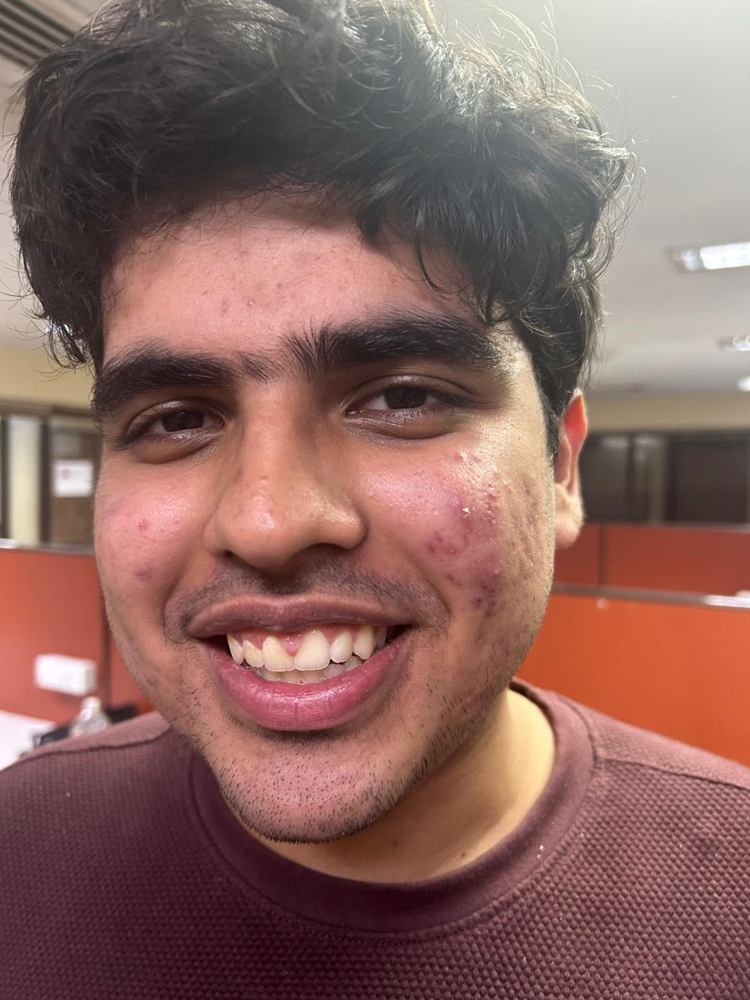

In [ ]:
img_path = '/content/WhatsApp Image 2025-04-19 at 01.40.59.jpeg'
image = cv2.imread(img_path)
image.shape[0]
cv2_imshow(image)

if image.shape[0] > 2500:
  (h, w) = image.shape[:2]
  image = cv2.resize(image, (int(w * 2500 / float(h)), 2500))
imageRGB = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
imageGRAY = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

#### 3.1. DLIB Library


First, we initialize a face detector using the dlib library.
The shape_predictor() function loads a pre-trained model that we had downloaded earlier, which is capable of predicting the locations of 68 facial landmarks in an image.

In [ ]:
detector = dlib.get_frontal_face_detector()
predictor = dlib.shape_predictor('shape_predictor_68_face_landmarks.dat')

We use the detector() function returns a list of rectangles, where each rectangle represents the bounding box of a detected face.

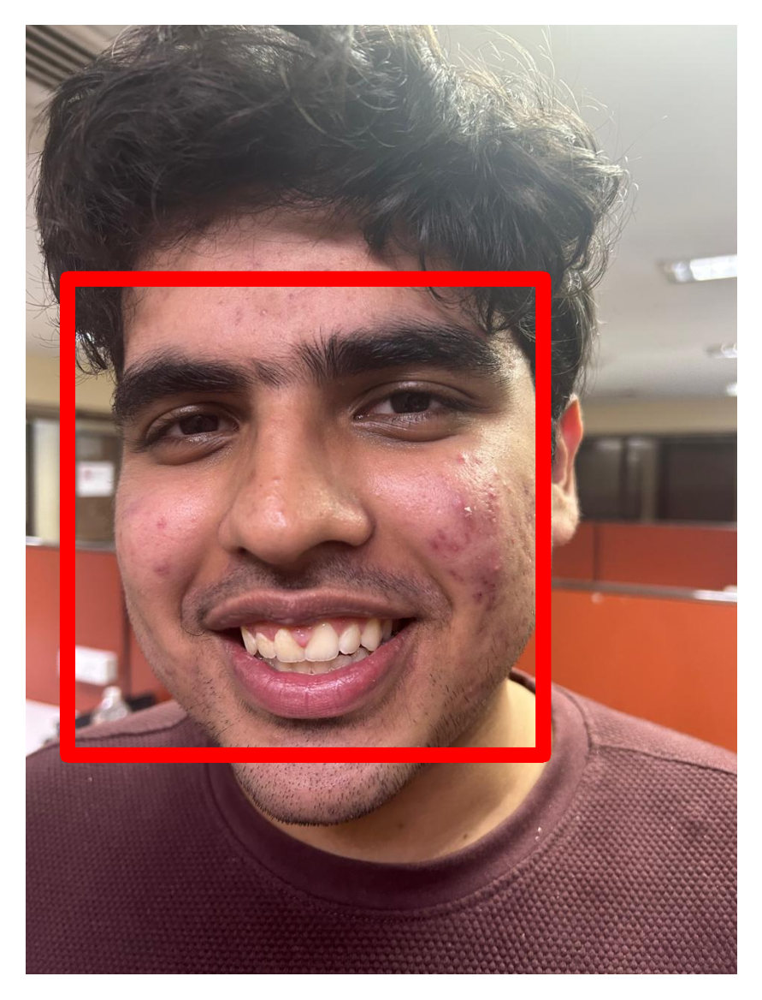

In [ ]:
faces = detector(imageGRAY)
img = imageRGB.copy()
for face in faces:
    x = face.left()
    y = face.top()
    w = face.right() - x
    h = face.bottom() - y
    img = cv2.rectangle(img, (x, y), (x + w,y + h), (255, 0, 0), 20)
plot_img(img)

Plotting the 68 Landmark points for each detected face

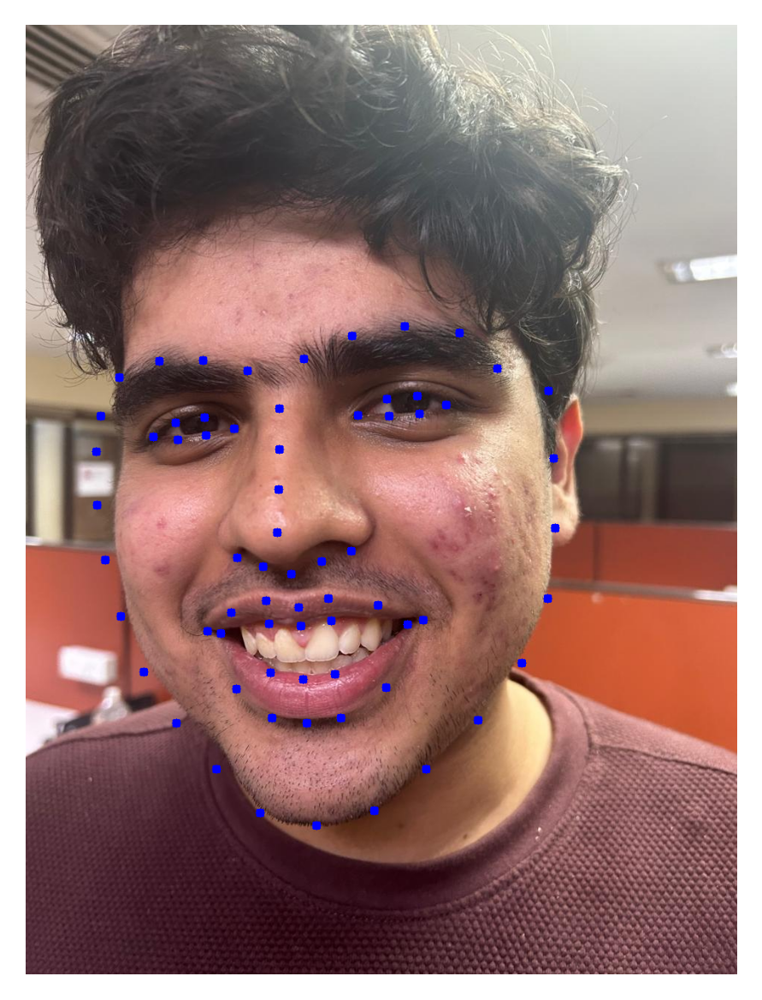

In [ ]:
for face in faces:
  shape = predictor(imageGRAY, face)

image_draw = imageRGB.copy()
coords = np.zeros((68, 2))
for i in range(0, 68):
  coords[i] = (shape.part(i).x, shape.part(i).y)
for points in coords:
  cv2.circle(image_draw, (points[0].astype(int), points[1].astype(int)), 1, (0, 0, 255), 10)
plot_img(image_draw)

#### 3.2 Face Alignment Network (FAN) + Additional keypoints generation

Depicting Original Image and Image with Facial Points

(np.float64(-0.5), np.float64(959.5), np.float64(1279.5), np.float64(-0.5))

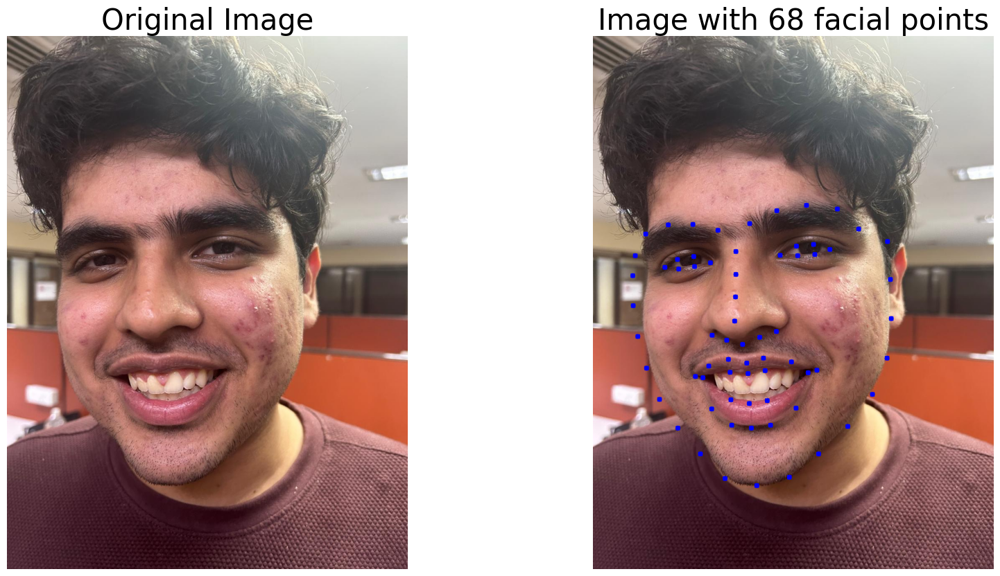

In [ ]:
fig, ax = plt.subplots(1, 2, figsize=(20, 10))

ax[0].imshow(imageRGB)
ax[0].set_title('Original Image', fontsize=30)
ax[0].axis('off')

ax[1].imshow(image_draw)
ax[1].set_title('Image with 68 facial points', fontsize=30)
ax[1].axis('off')

Initializing the face alignment model using the face_alignment library.

The model is configured to predict 2D facial landmarks and returns a list of
predicted landmarks for each detected face in the image.

Downloading: "https://www.adrianbulat.com/downloads/python-fan/s3fd-619a316812.pth" to /root/.cache/torch/hub/checkpoints/s3fd-619a316812.pth
100%|██████████| 85.7M/85.7M [00:05<00:00, 17.3MB/s]
Downloading: "https://www.adrianbulat.com/downloads/python-fan/2DFAN4-cd938726ad.zip" to /root/.cache/torch/hub/checkpoints/2DFAN4-cd938726ad.zip
100%|██████████| 91.9M/91.9M [00:06<00:00, 14.3MB/s]


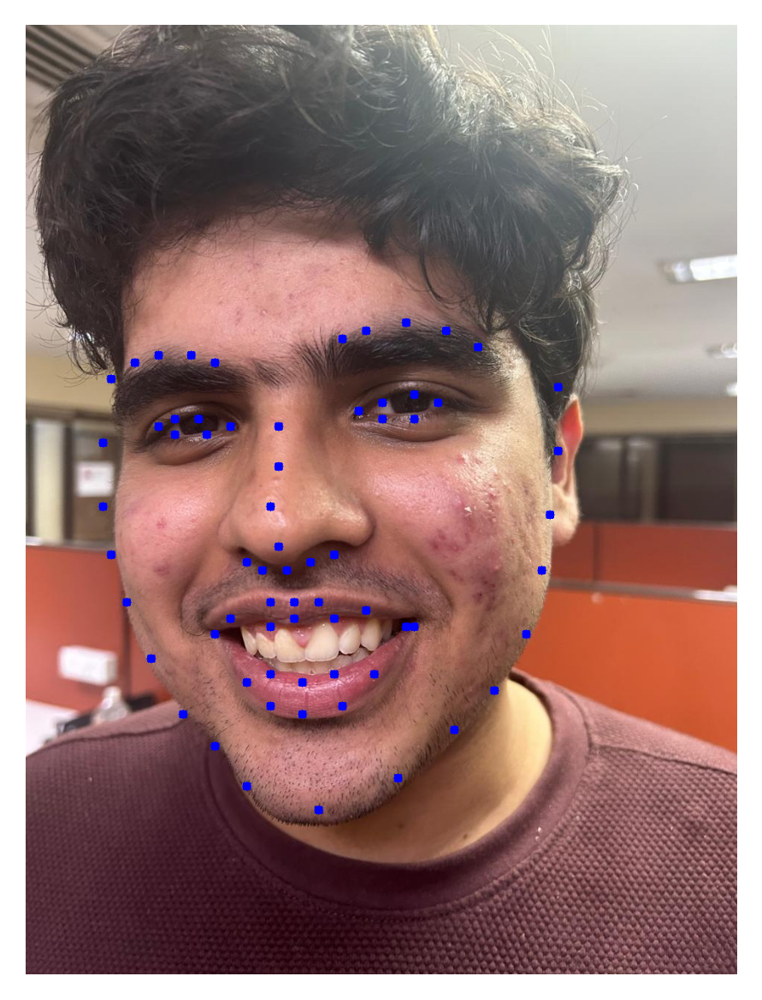

In [ ]:
fa = face_alignment.FaceAlignment(face_alignment.LandmarksType.TWO_D, flip_input=False)
preds = fa.get_landmarks_from_image(imageRGB)

image_draw = copy(imageRGB)
for points in preds[0]:
  cv2.circle(image_draw, (points[0].astype(int), points[1].astype(int)), 1, (0, 0, 255), 10)
plot_img(image_draw)

Finding Forehead points additional to the landmark points to provide more context and information about the facial structure.

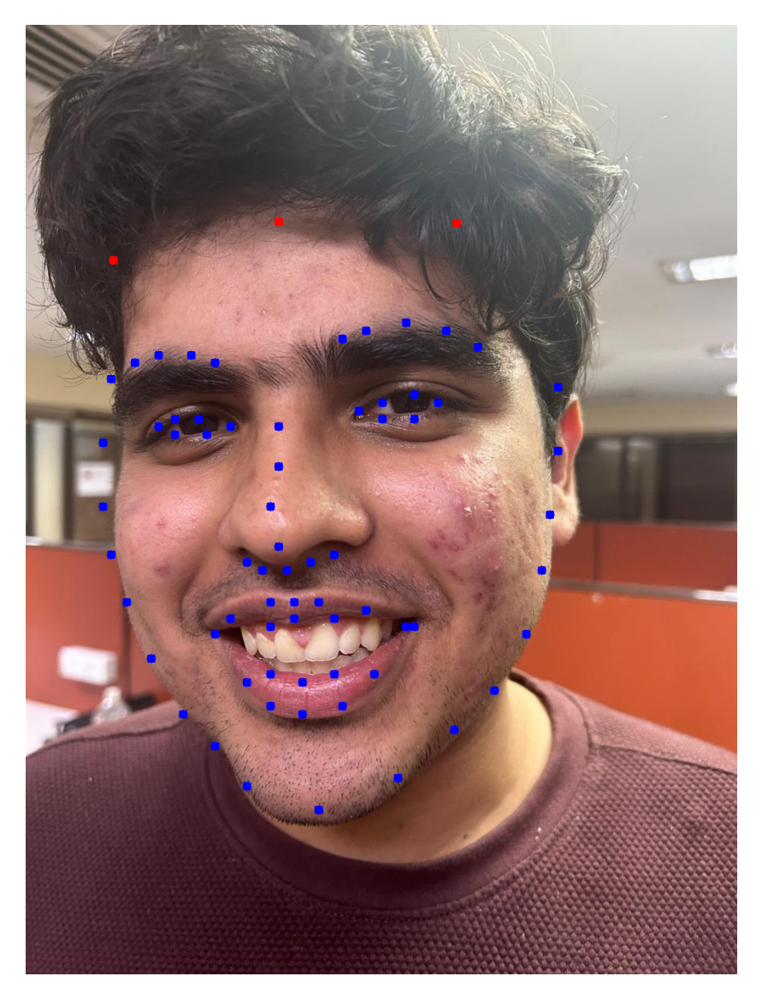

In [ ]:
image_draw = copy(imageRGB)

for points in preds[0]:
  cv2.circle(image_draw, (points[0].astype(int), points[1].astype(int)), 1, (0, 0, 255), 10)

# Additional points for forehead
for points in add_points(preds[0]):
  cv2.circle(image_draw, (points[0].astype(int), points[1].astype(int)), 1, (255, 0, 0), 10)


plot_img(image_draw)

We then find the Convex Hull of all the detected faces.

Convex Hull represents the outer boundary of the facial landmarks and helps in understanding the overall shape and structure of the face for better face alignment.

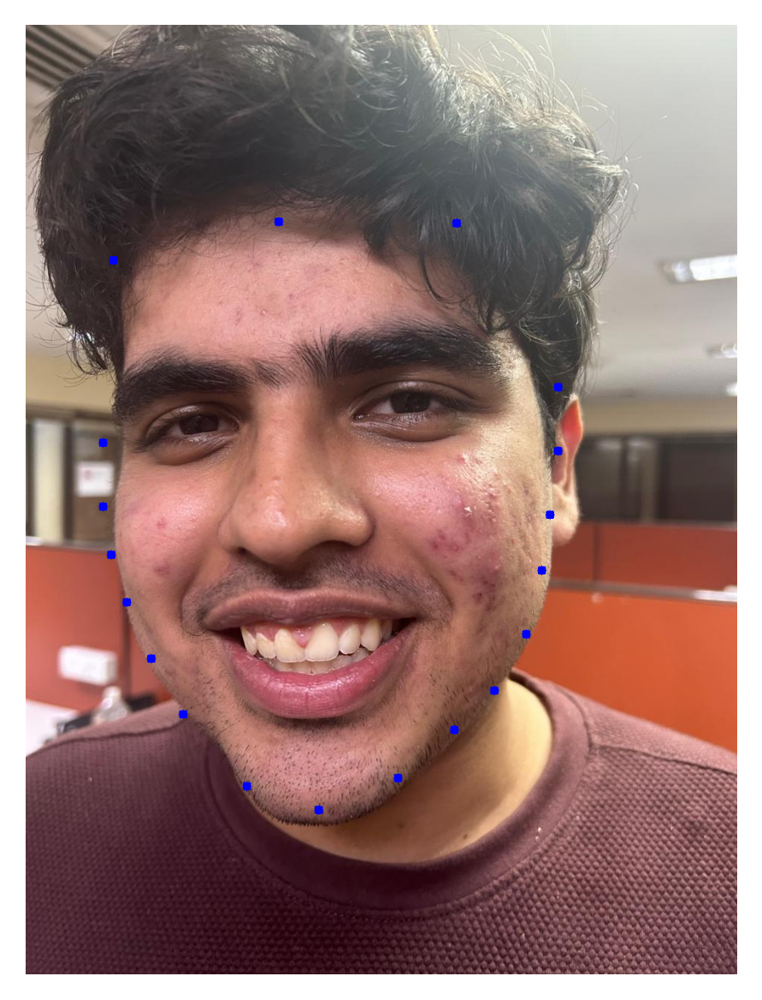

In [ ]:
image_draw = copy(imageRGB)
points_71 = np.vstack((preds[0], add_points(preds[0])))

# Convert all points to float
points_71 = points_71.astype(float)

# Convert to MultiPoint object
multi_point = MultiPoint(list(map(tuple, points_71)))

# Extract hull coordinates
hull = multi_point.convex_hull
hull_pts_x, hull_pts_y = hull.exterior.coords.xy

# Draw circles on the image for each hull point
for i in range(len(hull_pts_x)):
    center_x = int(hull_pts_x[i])
    center_y = int(hull_pts_y[i])
    cv2.circle(image_draw, (center_x, center_y), 1, (0, 0, 255), 10)

plot_img(image_draw)

### 4. Pimple detection

For Acne Detection, we have used shown below 2 competeting methods - Thresholding based on skin color and Thresholding on Difference.

We then compare both these methods using the final_dataset and use the better one.

#### 4.1. Thresholding based on skin color

We fill the Convex Hull of facial landmarks with white color, mask the original image and perform erosion operation to refine the mask

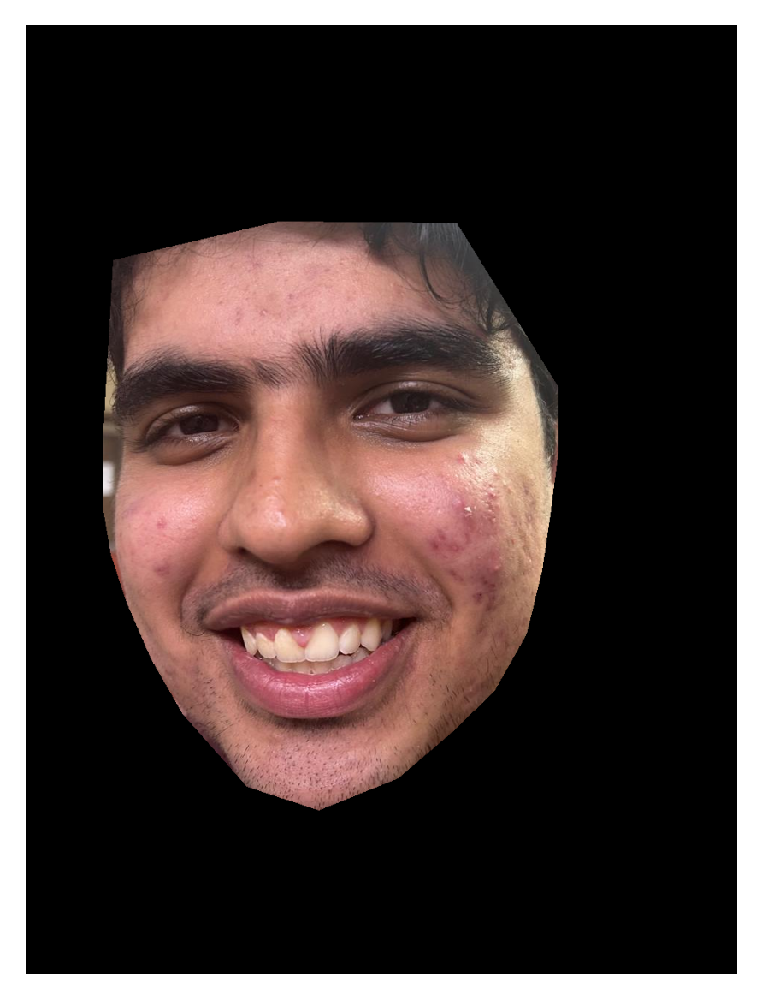

In [ ]:
img_cnt = np.zeros(imageRGB.shape[:-1])
image_draw = copy(imageRGB)

face = np.vstack([np.array(hull_pts_x), np.array(hull_pts_y)]).T
cv2.fillPoly(img_cnt, pts = [face.astype(int)], color=(1))
image_draw[img_cnt == 0] = 0

plt.figure(dpi = 300)
plt.imshow(image_draw)
plt.axis('off')

kernel = np.ones((5,5),np.uint8)
eros = cv2.erode(img_cnt, kernel,iterations = 5)

We now segment the facial parts using landmark indices and extract various landmarks such as left_eyebrow, right_eyebrow.

We also check if the face if left-tilted or right-tilted and consider concerned landmarks.

We also convert the RGB Image to LAB color space to analyze the A channel

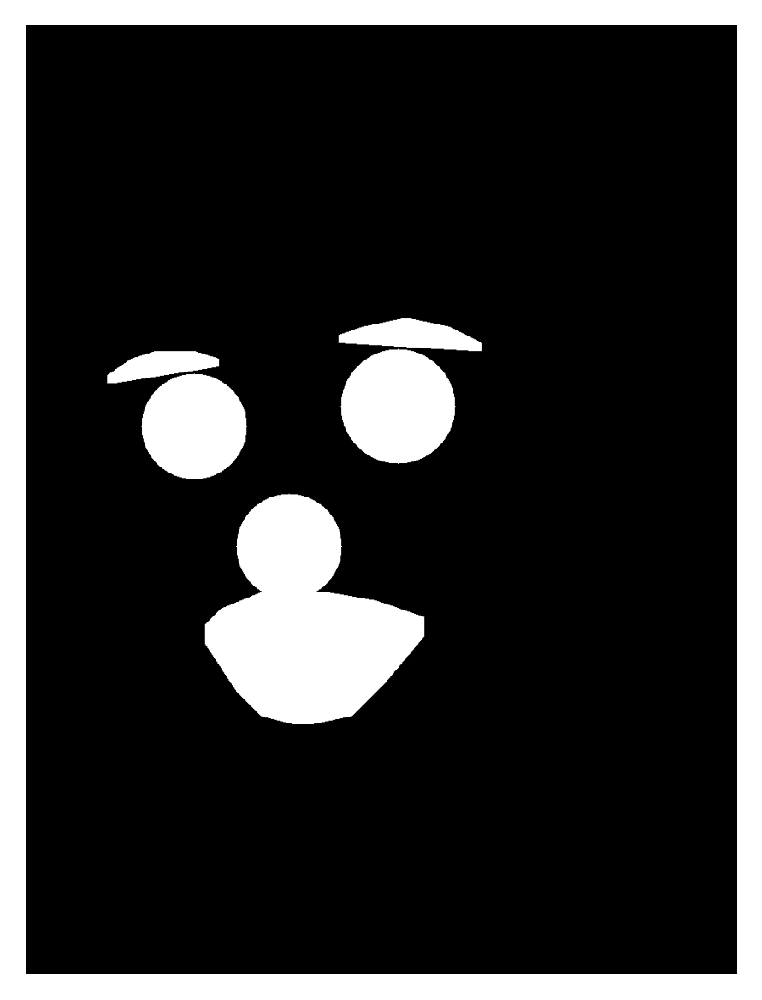

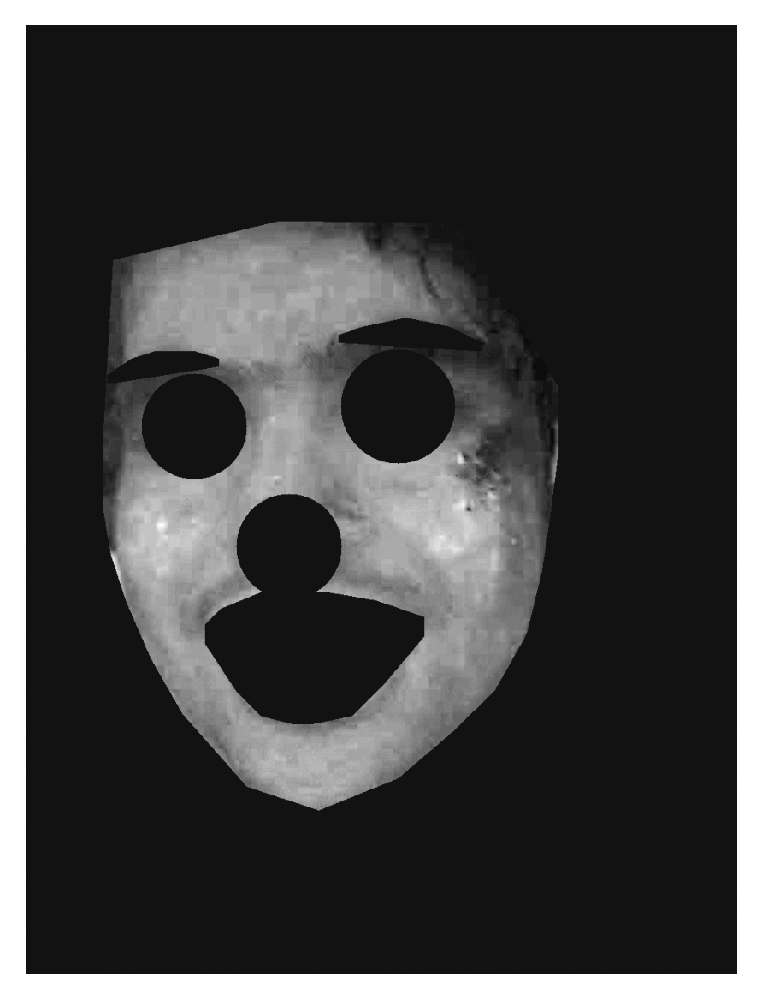

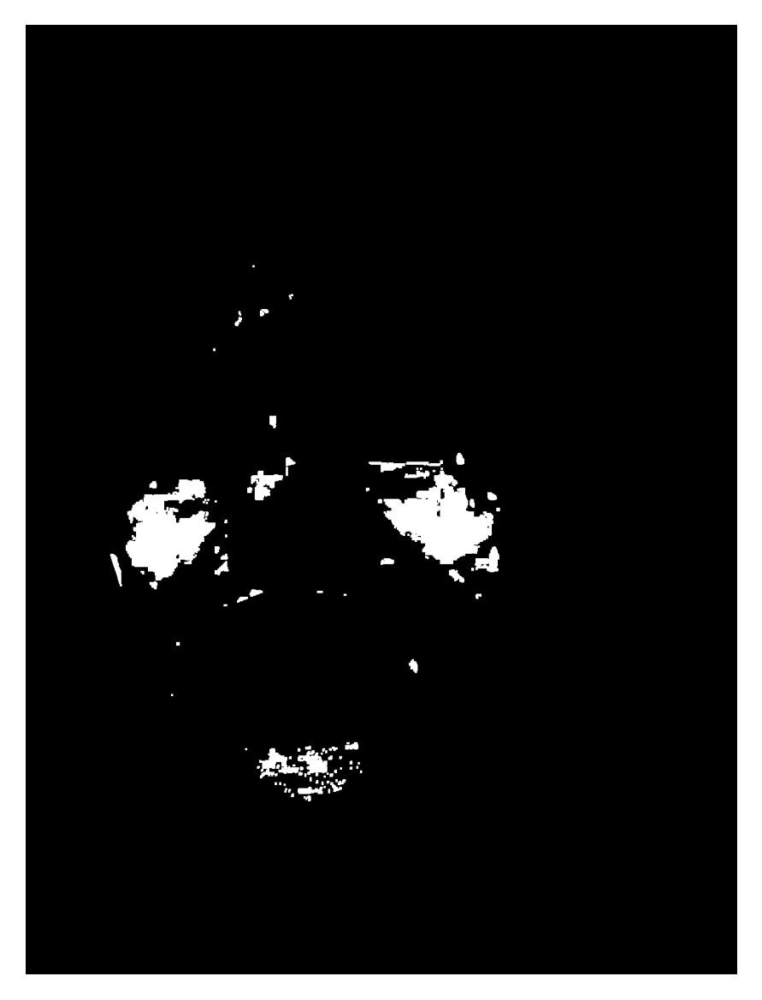

In [ ]:
img_cnt_1 = np.zeros(imageRGB.shape[:-1])

#Defining various facial features
left_eyebrow = points_71[17:22]
right_eyebrow = points_71[22:27]
left_eye = points_71[36:42]
right_eye = points_71[42:48]
mouth = points_71[48:60]
nose = points_71[29:36]

nose_n = cv2.convexHull(nose.astype(int))[:, 0, :]
alpha = MultiPoint(list(map(tuple,mouth)))
hull = alpha.convex_hull
hull_pts_x_m, hull_pts_y_m = hull.exterior.coords.xy
mouth_m = np.vstack([np.array(hull_pts_x_m), np.array(hull_pts_y_m)]).T

#Checking if face is left-tilted, right-tilted or straight
if points_71[16][0] < points_71[33][0]: #Left Tilted
  face_parts = [left_eyebrow, left_eye, nose_n, mouth_m]
  iterations = [5, 20, 8, 13] #Right Tilted
  labels = ['eyebrow', 'eye', 'nose', 'mouth']
elif points_71[1][0] > points_71[33][0]:
  face_parts = [right_eyebrow, right_eye, nose_n, mouth_m]
  iterations = [5, 20, 8, 13]
  labels = ['eyebrow', 'eye', 'nose', 'mouth']
else:
  face_parts = [left_eyebrow, left_eye, right_eyebrow, right_eye, nose_n, mouth_m]
  iterations = [5, 20, 5, 20, 8, 13]
  labels = ['eyebrow', 'eye', 'eyebrow', 'eye', 'nose', 'mouth']

for (part, iter, label) in zip(face_parts, iterations, labels):
  img_iter = np.zeros(imageRGB.shape[:-1])
  cv2.fillPoly(img_iter, pts = [part.astype(int)], color=(1))
  img_iter = cv2.dilate(img_iter, kernel=np.ones((3, 3)), iterations=iter)
  if (label == 'eye') | (label == 'nose'):
    contours, hierarchy = cv2.findContours(img_iter.astype(np.uint8), cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
    (x,y),radius = cv2.minEnclosingCircle(contours[0])
    center = (int(x),int(y))
    if (label == 'nose'):
      radius = int(radius*1)
    if (label == 'eye'):
      radius = int(radius*1)
    cv2.circle(img_iter, center, radius, (1), -1)
  img_cnt_1 += img_iter
img_cnt_1 = (img_cnt_1>0)*1
plot_img(img_cnt_1)

acne_mask = image_draw.copy()
img_lab = cv2.cvtColor(acne_mask, cv2.COLOR_RGB2LAB)

A = img_lab[:, :, 1]
A[img_cnt_1 > 0] = 128

plot_img(A)

th = np.sum(A*(A > 128))/(np.sum(1*(A > 128)))
A_th = (A>th*1.055).astype(np.uint8)
kernel = np.ones((3,3))
A_th = cv2.morphologyEx(A_th, cv2.MORPH_CLOSE, kernel, iterations = 1)
A_th = cv2.dilate(np.uint8(A_th), kernel=np.ones((3, 3)), iterations = 1)

plot_img(A_th)

A_th[img_cnt_1 > 0] = 0
img_bin = A_th.copy()

Displaying the Image with Acne Maks

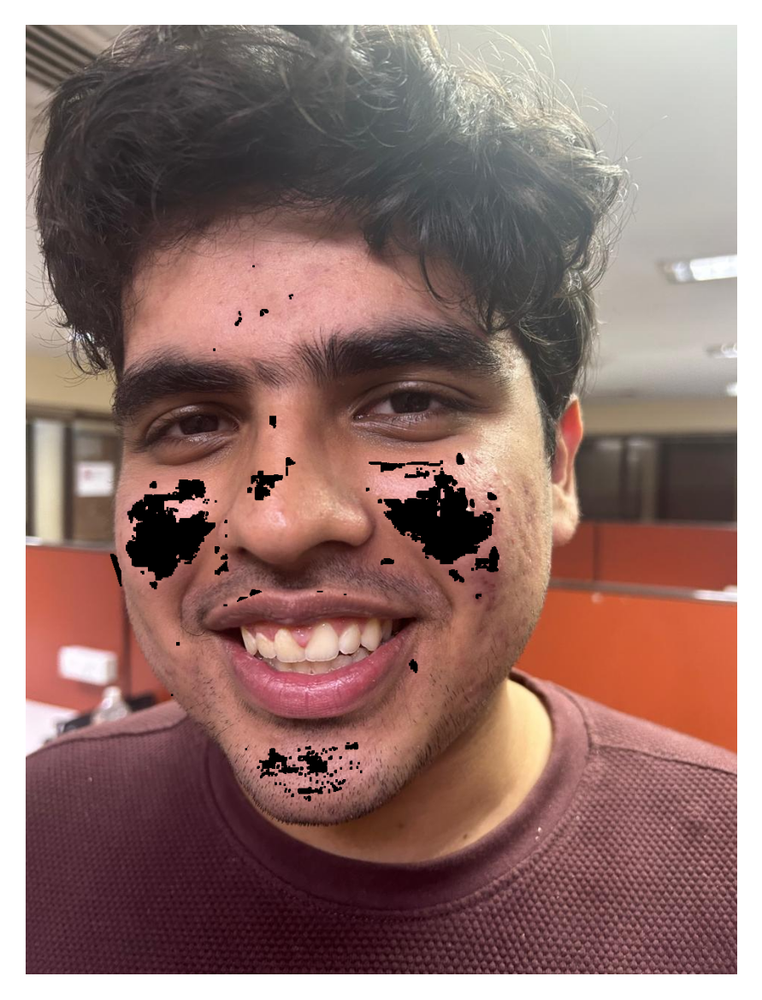

In [ ]:
final_img = imageRGB.copy()
final_img[img_bin == 1] = 0
acne_mask = np.ones(img_bin.shape)
acne_mask[img_bin == 1] = 0

plot_img(final_img)

prediction = acne_mask.astype(np.uint8)-1

#### 4.2. Thresholding on difference

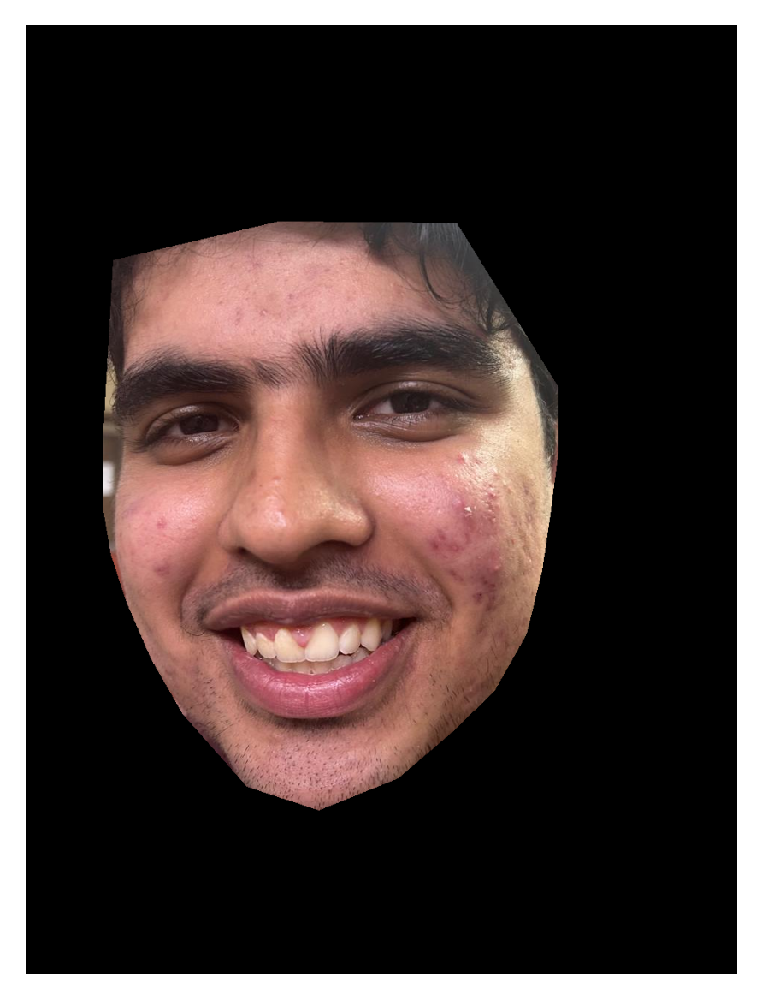

In [ ]:
img_cnt = np.zeros(imageRGB.shape[:-1])
image_draw = copy(imageRGB)

face = np.vstack([np.array(hull_pts_x), np.array(hull_pts_y)]).T
cv2.fillPoly(img_cnt, pts = [face.astype(int)], color=(1))
image_draw[img_cnt == 0] = 0

plt.figure(dpi = 300)
plt.imshow(image_draw)
plt.axis('off')

kernel = np.ones((5,5),np.uint8)
eros = cv2.erode(img_cnt, kernel,iterations = 5)

The code applies thresholding (diff > 42) and morphological operations (dilation) to isolate regions that potentially contain acne.

It calculates the difference between the original feature and a Gaussian blurred version (A - GB).

This likely helps in highlighting certain patterns or anomalies in these features.

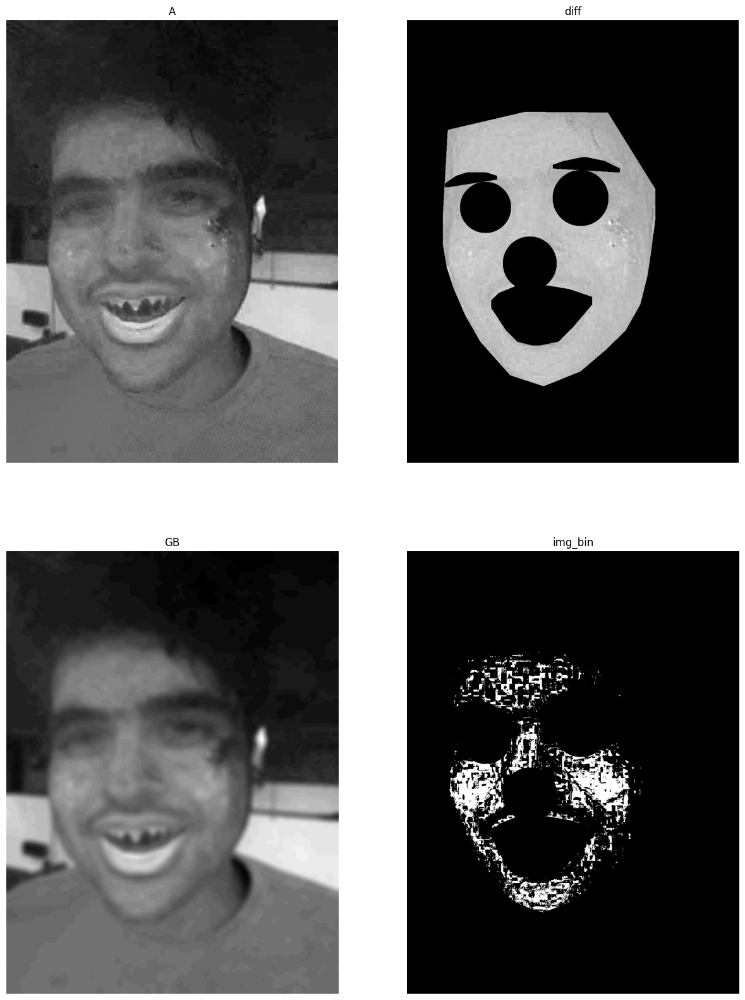

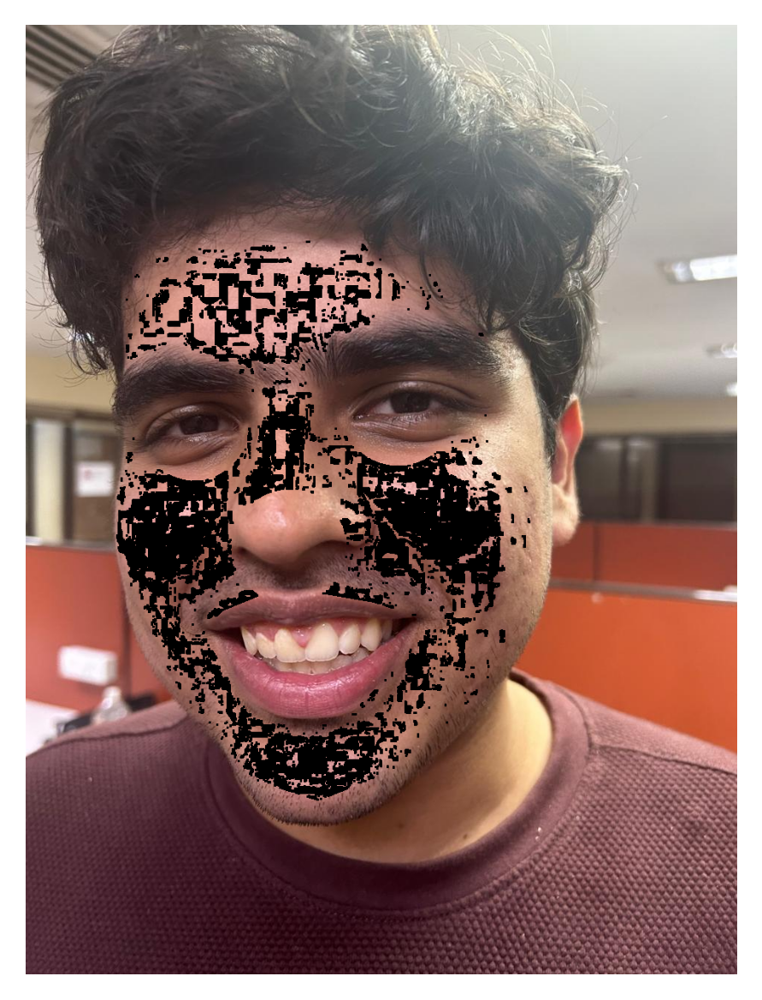

In [ ]:
# img_cnt_1 -- > represent the regions of interest (facial features) in the image.
# contains non-zero values where facial features are detected.
# img_cnt --> It is the polygon of face fored from the precomputed hull points .
# diff --> This likely identifies areas where facial features are not present or where the mask img_cnt is not active.

img_cnt_1 = np.zeros(imageRGB.shape[:-1])

left_eyebrow = points_71[17:22]
right_eyebrow = points_71[22:27]
left_eye = points_71[36:42]
right_eye = points_71[42:48]
mouth = points_71[48:60]
nose = points_71[29:36]

acne_mask = imageRGB.copy()
img_lab = cv2.cvtColor(acne_mask, cv2.COLOR_RGB2LAB)
img_hsv = cv2.cvtColor(acne_mask, cv2.COLOR_RGB2HSV)
img_hls = cv2.cvtColor(acne_mask, cv2.COLOR_RGB2HLS)
img_gray = cv2.cvtColor(acne_mask, cv2.COLOR_RGB2GRAY)

L = img_lab[:, :, 0]
A = img_lab[:, :, 1]
B = img_lab[:, :, 2]

fig, ax = plt.subplots(2, 2, figsize=(15, 20))
ax[0][0].imshow(A, cmap='gray')
ax[0][0].set_title('A')
ax[0][0].axis('off')

kernel = np.ones((19,19), np.float32)/500
GB = cv2.filter2D(A ,-1, kernel)
ax[1][0].imshow(GB, cmap='gray')
ax[1][0].set_title('GB')
ax[1][0].axis('off')

diff = A-GB

nose_n = cv2.convexHull(nose.astype(int))[:, 0, :]
alpha = MultiPoint(list(map(tuple,mouth)))
hull = alpha.convex_hull
hull_pts_x_m, hull_pts_y_m = hull.exterior.coords.xy

mouth_m = np.vstack([np.array(hull_pts_x_m), np.array(hull_pts_y_m)]).T

if points_71[16][0] < points_71[33][0]:
  face_parts = [left_eyebrow, left_eye, nose_n, mouth_m]
  iterations = [5, 20, 8, 11]
  labels = ['eyebrow', 'eye', 'nose', 'mouth']
elif points_71[1][0] > points_71[33][0]:
  face_parts = [right_eyebrow, right_eye, nose_n, mouth_m]
  iterations = [5, 20, 8, 11]
  labels = ['eyebrow', 'eye', 'nose', 'mouth']
else:
  face_parts = [left_eyebrow, left_eye, right_eyebrow, right_eye, nose_n, mouth_m]
  iterations = [5, 20, 5, 20, 8, 11]
  labels = ['eyebrow', 'eye', 'eyebrow', 'eye', 'nose', 'mouth']

for (part, iter, label) in zip(face_parts, iterations, labels):
  img_iter = np.zeros(imageRGB.shape[:-1])
  cv2.fillPoly(img_iter, pts = [part.astype(int)], color=(1))
  img_iter = cv2.dilate(img_iter, kernel=np.ones((3, 3)), iterations=iter)
  if (label == 'eye') | (label == 'nose'):
    contours, hierarchy = cv2.findContours(img_iter.astype(np.uint8), cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
    (x,y),radius = cv2.minEnclosingCircle(contours[0])
    center = (int(x),int(y))
    if (label == 'nose'):
      radius = int(radius*1.1)
    if (label == 'eye'):
      radius = int(radius*1.05)
    cv2.circle(img_iter, center, radius, (1), -1)
  img_cnt_1 += img_iter
img_cnt_1 = (img_cnt_1>0)*1
diff[(img_cnt_1 - 1)*(-1)*img_cnt == 0] = 0


ax[0][1].imshow(diff, cmap='gray')
ax[0][1].set_title('diff')
ax[0][1].axis('off')

# thresholding the intensity value
img_bin = (diff>42)*1
img_bin[eros == 0] = 0
ax[1][1].imshow(img_bin, cmap='gray')
ax[1][1].set_title('img_bin')
ax[1][1].axis('off')

final_img = imageRGB.copy()
img_bin = cv2.dilate(np.uint8(img_bin), kernel=np.ones((3, 3)), iterations = 1)
final_img[img_bin == 1] = 0
acne_mask = np.ones(img_bin.shape)
acne_mask[img_bin == 1] = 0

prediction = acne_mask.astype(np.uint8)-1

plot_img(final_img)

### 5. Mode Selection by Image Processing and Metric Calculation

This function detects acne regions in a facial image by generating a binary mask using facial landmark-guided segmentation and adaptive thresholding.

It is used to compare two detection modes (skin color-based and intensity difference-based), and can optionally compare the predicted mask with ground truth to compute recall for evaluation.


In [ ]:
def find_mask(idx, path, mode, show = True):
  try:
    mask_path=""
    image = cv2.imread(path)
    image.shape[0]
  except (AttributeError) as e:
    img_path = f"final_dataset/images/t{idx}.png"
    mask_path = f"final_dataset/masks/t{idx}_mask.png"
    image = cv2.imread(img_path)

  if image.shape[0] > 2500:
    (h, w) = image.shape[:2]
    image = cv2.resize(image, (int(w * 2500 / float(h)), 2500))
  imageRGB = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)


  fa = face_alignment.FaceAlignment(face_alignment.LandmarksType.TWO_D, flip_input=False)
  preds = fa.get_landmarks_from_image(imageRGB)

  points_71 = np.vstack((preds[0], add_points(preds[0])))
  multi_point = MultiPoint(list(map(tuple, points_71)))

  # Extract hull coordinates
  hull = multi_point.convex_hull
  hull_pts_x, hull_pts_y = hull.exterior.coords.xy

  img_cnt = np.zeros(imageRGB.shape[:-1])
  image_draw = copy(imageRGB)

  face = np.vstack([np.array(hull_pts_x), np.array(hull_pts_y)]).T
  cv2.fillPoly(img_cnt, pts = [face.astype(int)], color=(1))
  image_draw[img_cnt == 0] = 0

  kernel = np.ones((5,5),np.uint8)
  eros = cv2.erode(img_cnt, kernel,iterations = 5)

  img_cnt_1 = np.zeros(imageRGB.shape[:-1])
  left_eyebrow = points_71[17:22]
  right_eyebrow = points_71[22:27]
  left_eye = points_71[36:42]
  right_eye = points_71[42:48]
  mouth = points_71[48:60]
  nose = points_71[29:36]

  nose_n = cv2.convexHull(nose.astype(int))[:, 0, :]

  multi_point = MultiPoint(list(map(tuple, mouth)))

  # Extract hull coordinates
  hull = multi_point.convex_hull
  hull_pts_x_m, hull_pts_y_m = hull.exterior.coords.xy

  mouth_m = np.vstack([np.array(hull_pts_x_m), np.array(hull_pts_y_m)]).T

  if points_71[16][0] < points_71[33][0]:
    face_parts = [left_eyebrow, left_eye, nose_n, mouth_m]
    iterations = [5, 20, 8, 11]
    labels = ['eyebrow', 'eye', 'nose', 'mouth']
  elif points_71[1][0] > points_71[33][0]:
    face_parts = [right_eyebrow, right_eye, nose_n, mouth_m]
    iterations = [5, 20, 8, 11]
    labels = ['eyebrow', 'eye', 'nose', 'mouth']
  else:
    face_parts = [left_eyebrow, left_eye, right_eyebrow, right_eye, nose_n, mouth_m]
    iterations = [5, 20, 5, 20, 8, 11]
    labels = ['eyebrow', 'eye', 'eyebrow', 'eye', 'nose', 'mouth']

  for (part, iter, label) in zip(face_parts, iterations, labels):
    img_iter = np.zeros(imageRGB.shape[:-1])
    cv2.fillPoly(img_iter, pts = [part.astype(int)], color=(1))
    img_iter = cv2.dilate(img_iter, kernel=np.ones((3, 3)), iterations=iter)
    if (label == 'eye') | (label == 'nose'):
      contours, hierarchy = cv2.findContours(img_iter.astype(np.uint8), cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
      (x,y),radius = cv2.minEnclosingCircle(contours[0])
      center = (int(x),int(y))
      if (label == 'nose'):
        radius = int(radius*1.1)
      if (label == 'eye'):
        radius = int(radius*1.05)
      cv2.circle(img_iter, center, radius, (1), -1)
    img_cnt_1 += img_iter
  img_cnt_1 = (img_cnt_1>0)*1

  img_lab = cv2.cvtColor(imageRGB.copy(), cv2.COLOR_RGB2LAB)

  A = img_lab[:, :, 1]

  if mode == '1st':
    A[img_cnt_1 > 0] = 128
    A[img_cnt == 0] = 128
    th = np.sum(A*(A > 128))/(np.sum(1*(A > 128)))
    A_th = (A>th*1.05).astype(np.uint8)
    kernel = np.ones((3,3))
    A_th = cv2.morphologyEx(A_th, cv2.MORPH_CLOSE, kernel, iterations = 1)
    A_th = cv2.dilate(np.uint8(A_th), kernel=np.ones((3, 3)), iterations = 1)
    A_th[img_cnt_1 > 0] = 0
    img_bin = A_th.copy()

    final_img = imageRGB.copy()
    final_img[img_bin == 1] = 0
    acne_mask = np.ones(img_bin.shape)
    acne_mask[img_bin == 1] = 0
    prediction = acne_mask.astype(np.uint8)-1

  if mode == '2nd':
    kernel = np.ones((19,19), np.float32)/500
    GB = cv2.filter2D(A ,-1, kernel)
    diff = A-GB
    diff[(img_cnt_1 - 1)*(-1)*img_cnt == 0] = 0

    img_bin = (diff>42)*1
    img_bin[eros == 0] = 0

    final_img = imageRGB.copy()
    img_bin = cv2.dilate(np.uint8(img_bin), kernel=np.ones((3, 3)), iterations = 1)
    final_img[img_bin == 1] = 0
    acne_mask = np.ones(img_bin.shape)
    acne_mask[img_bin == 1] = 0
    prediction = acne_mask.astype(np.uint8)-1

  if show==False:
    if(mask_path==""):
      mask_path = f"final_dataset/masks/t{idx}_mask.jpg"
    ground_truth = cv2.imread(mask_path)
    ground_truth = cv2.cvtColor(ground_truth, cv2.COLOR_BGR2GRAY)
    ground_truth = np.uint8((ground_truth > 240)*255)
    score = calculate_recall([prediction], [ground_truth])

  if show:
    fig, ax = plt.subplots(2, 1, figsize=(10, 20))

    ax[0].imshow(imageRGB)
    ax[0].set_title('Image')
    ax[0].axis('off')

    superpos_pr = imageRGB.copy()
    superpos_pr[prediction == 255] = 0
    ax[1].imshow(superpos_pr)
    ax[1].set_title('Superposotion_prediction')
    ax[1].axis('off')

    return final_img, prediction, acne_mask

  return final_img, prediction, acne_mask, score

Comparison of the two methods

In [ ]:
scores_1 = []
scores_2 = []
for idx in range(1,31):
  final_img, prediction, acne_mask, score = find_mask(idx=idx, path = f"final_dataset/images/t{idx}.jpg", mode = '1st', show = False)
  scores_1.append(score)
  final_img, prediction, acne_mask, score = find_mask(idx=idx, path = f"final_dataset/images/t{idx}.jpg", mode = '2nd', show = False)
  scores_2.append(score)
  print(idx, '\t', round(scores_1[idx-1], 3), '\t', round(scores_2[idx-1], 3))

1 	 0.681 	 0.573
2 	 0.95 	 0.619
3 	 0.458 	 0.531
4 	 0.634 	 0.774
5 	 0.131 	 0.148
6 	 0.353 	 0.597
7 	 0.075 	 0.07
8 	 0.44 	 0.868
9 	 0.27 	 0.667
10 	 0.693 	 0.465
11 	 0.771 	 0.683
12 	 0.362 	 0.304
13 	 0.685 	 0.567
14 	 0.611 	 0.715
15 	 0.554 	 0.545
16 	 0.442 	 0.448
17 	 0.333 	 0.546
18 	 0.493 	 0.6
19 	 0.534 	 0.608
20 	 0.239 	 0.305
21 	 0.358 	 0.3
22 	 0.479 	 0.617
23 	 0.475 	 0.493
24 	 0.117 	 0.06
25 	 0.126 	 0.12
26 	 0.202 	 0.519
27 	 0.332 	 0.494
28 	 0.668 	 0.798
29 	 0.373 	 0.38
30 	 0.423 	 0.52


Printing Mean Scores of the two methodologies

In [ ]:
scores_1 = np.array(scores_1)
scores_2 = np.array(scores_2)

print(np.mean(scores_1))
print(np.mean(scores_2))

0.442041
0.49789426


We decide which mode(method) to use based on which method gives the higher mean score

In [ ]:
if np.mean(scores_1)>np.mean(scores_2):
  mode= '1st'
else:
  mode='2nd'

print(mode)

2nd


### 6. Inpainting

Getting Test Image again

In [ ]:
image = cv2.imread(f'/content/WhatsApp Image 2025-04-19 at 01.40.59.jpeg')
image.shape[0]
imageRGB = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

Displaying Mask Prediction

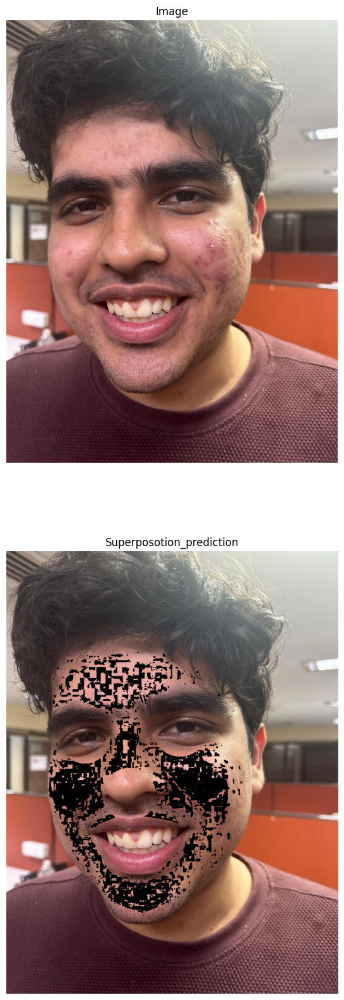

In [ ]:
final_img, prediction, acne_mask = find_mask(idx=idx, path = f'/content/WhatsApp Image 2025-04-19 at 01.40.59.jpeg', mode = mode, show = True)

We have used 2 methods for Pimple Removal (Impainting).
Both these methods and their results have been depicted below.

#### 6.1. OpenCV Integrated Inpainting

Displaying Result obtained via OpenCV Integrated Impainting using the Telea method

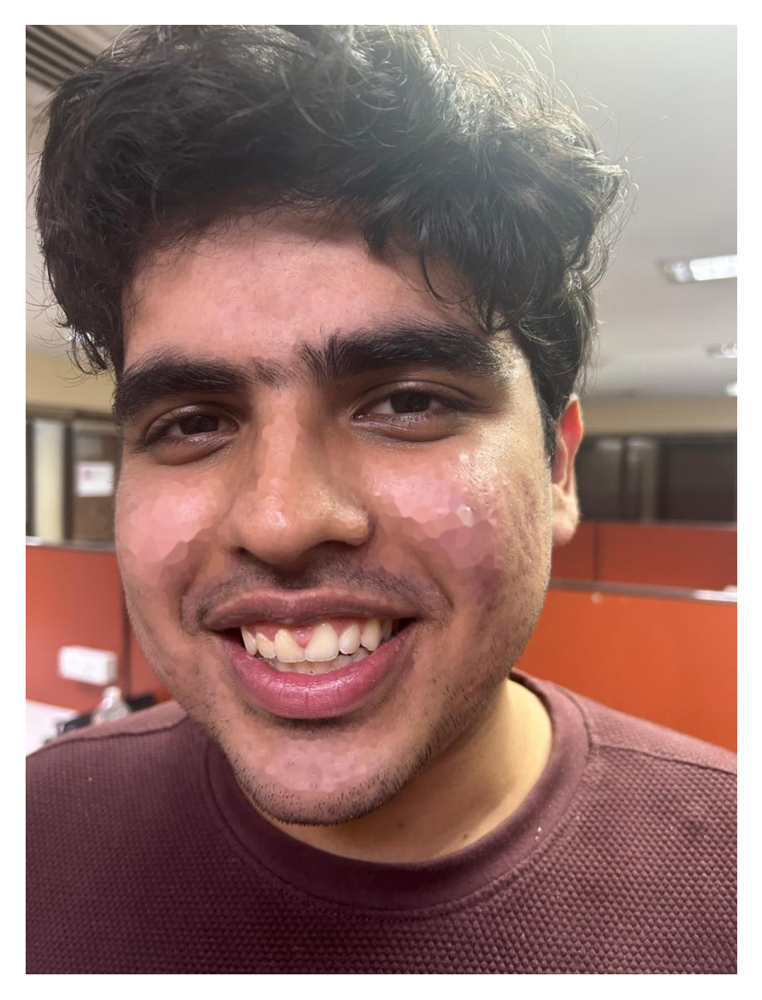

In [ ]:
inpainted_by_cv2 = cv2.inpaint(final_img, (acne_mask.astype(np.uint8)-1), 3, cv2.INPAINT_TELEA)
cv2.imwrite('inpainted_by_cv2.jpg', np.uint8(cv2.cvtColor(np.uint8(inpainted_by_cv2), cv2.COLOR_RGB2BGR)))
plot_img(inpainted_by_cv2)

#### 6.2. Deep Image Prior using UNet CNN

Importing relevant libraries for UNet CNN

In [ ]:
import os
import torch
from torch import nn
from torch.utils.data import DataLoader, Dataset

import matplotlib.pyplot as plt
import numpy as np
%matplotlib inline

import torchvision
from torchvision import transforms, models
from PIL import Image
import glob
import random
from tqdm.notebook import tqdm

Custom U-Net model for neural inpainting:

Defines the encoder, decoder, and skip connections for a deep neural network that restores masked facial regions by generating realistic skin textures.
Used as the backbone for Deep Image Prior-based acne removal.

In [ ]:
class Down(nn.Module):
    def __init__(self, in_channels, out_channels, p):
        super().__init__()

        self.conv1 = nn.Conv2d(in_channels, out_channels, kernel_size=3, padding=1)
        self.bn1 = nn.InstanceNorm2d(out_channels)
        self.drop = nn.Dropout(p)
        self.relu1 = nn.LeakyReLU()
        self.conv2 = nn.Conv2d(out_channels, out_channels, kernel_size=3, padding=1)
        self.bn2 = nn.InstanceNorm2d(out_channels)
        self.relu2 = nn.LeakyReLU()

        self.maxpool = nn.MaxPool2d(kernel_size=2)

    def forward(self, x):

        out = self.conv1(x)
        out = self.bn1(out)
        out = self.drop(out)
        out = self.relu1(out)
        out = self.conv2(out)
        out = self.bn2(out)
        out_before_pooling = self.relu2(out)
        out = self.maxpool(out_before_pooling)

        return out, out_before_pooling

class Up(nn.Module):
    def __init__(self, in_channels, out_channels, p, concat=True, deconv=False, mode='nearest'):
        super().__init__()

        if deconv:
            self.upsample = nn.ConvTranspose2d(in_channels, in_channels, 4, stride=2, padding=1)
        else:
            self.upsample = nn.Upsample(scale_factor=2, mode=mode)
        if concat:
            self.conv1 = nn.Conv2d(2*in_channels, out_channels, kernel_size=3, padding=1)
        else:
            self.conv1 = nn.Conv2d(in_channels, out_channels, kernel_size=3, padding=1)
        self.bn1 = nn.InstanceNorm2d(out_channels)
        self.drop = nn.Dropout(p)
        self.relu1 = nn.LeakyReLU()
        self.conv2 = nn.Conv2d(out_channels, out_channels, kernel_size=3, padding=1)
        self.bn2 = nn.InstanceNorm2d(out_channels)
        self.relu2 = nn.LeakyReLU()
        self.concat = concat

    def forward(self, x, x_bridge):

        out = self.upsample(x)
        if self.concat:
            out = torch.cat([out, x_bridge], dim=1)
        out = self.conv1(out)
        out = self.bn1(out)
        out = self.drop(out)
        out = self.relu1(out)
        out = self.conv2(out)
        out = self.bn2(out)
        out = self.relu2(out)

        return out

class Unet(nn.Module):
  def __init__(self, p, base_channels=16, concat=True, deconv=False, mode='nearest'):
        super().__init__()

        self.down = nn.ModuleList([
            Down(3, base_channels, p),
            Down(base_channels, base_channels * 2, p),
            Down(base_channels * 2, base_channels * 4, p),
            Down(base_channels * 4, base_channels * 8, p),
            Down(base_channels * 8, base_channels * 8, p),
        ])
        self.up = nn.ModuleList([
            Up(base_channels * 8, base_channels * 4, p, concat, deconv, mode),
            Up(base_channels * 4, base_channels * 2, p, concat, deconv, mode),
            Up(base_channels * 2, base_channels, p, concat, deconv, mode),
            Up(base_channels, base_channels, p, concat, deconv, mode)
        ])
        self.final_block = nn.Sequential(
            nn.Conv2d(base_channels, 3, kernel_size=1),
            nn.Sigmoid()
        )


  def forward(self, x):
      out = x
      outputs_before_pooling = []
      for i, block in enumerate(self.down):
          out, before_pooling = block(out)
          outputs_before_pooling.append(before_pooling)
      out = before_pooling

      for i, block in enumerate(self.up):
          out = block(out, outputs_before_pooling[-i - 2])
      out = self.final_block(out)

      return out

In [ ]:
def crop_image(img, d=64):
    hor = img.shape[0] % d
    ver = img.shape[1] % d
    img_cropped = img[hor//2: img.shape[0] - (hor - hor//2), ver//2:img.shape[1]-(ver - ver//2)]
    return img_cropped

def imshow(images):
    for i in range(len(images)):
        plt.figure(figsize=(15, 15))
        plt.imshow(np.transpose(images[i].numpy(), (1, 2, 0)))
        plt.axis('off')

In [ ]:
kate = torch.from_numpy(crop_image(crop_image(final_img/255).astype(float), 16).transpose(2,0,1))
kate_mask = torch.from_numpy(crop_image(acne_mask).astype(float)).unsqueeze(0)

gen_kate = torch.Generator()
gen_kate.manual_seed(305)
z_kate = torch.FloatTensor(kate.shape).uniform_(0, 1, generator=gen_kate)

In [ ]:
model_kate = Unet(p=0.05).cuda()
criterion = nn.MSELoss()
optimizer_kate = torch.optim.Adam(model_kate.parameters(), lr=0.01)

In [ ]:
def train(epochs, model, image_train, mask, z, optimizer, iter):
    images = []
    for epoch in range(1, epochs + 1):
        # print(epoch)
        model.train()
        image_train = image_train.cuda()
        mask = mask.cuda()
        out_image = model(z[None, ...].cuda())
        loss = criterion(out_image*mask[None, ...], image_train[None, ...])

        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

        if epoch%iter == 0 or epoch == 1:
            model.eval()
            predict = model(z[None, ...].cuda())
            images.append(predict.detach().cpu().reshape(image_train.shape))


    return predict, images

Running the Deep Image Prior neural network to inpaint masked acne regions generating a restored facial image with natural skin texture.

In [ ]:
kate_impainting, kate_images = train(5000, model_kate, kate, kate_mask, z_kate, optimizer_kate, 500)

Displays and saves the raw neural inpainting output, showing the face with acne regions filled in by the Deep Image Prior network.

True

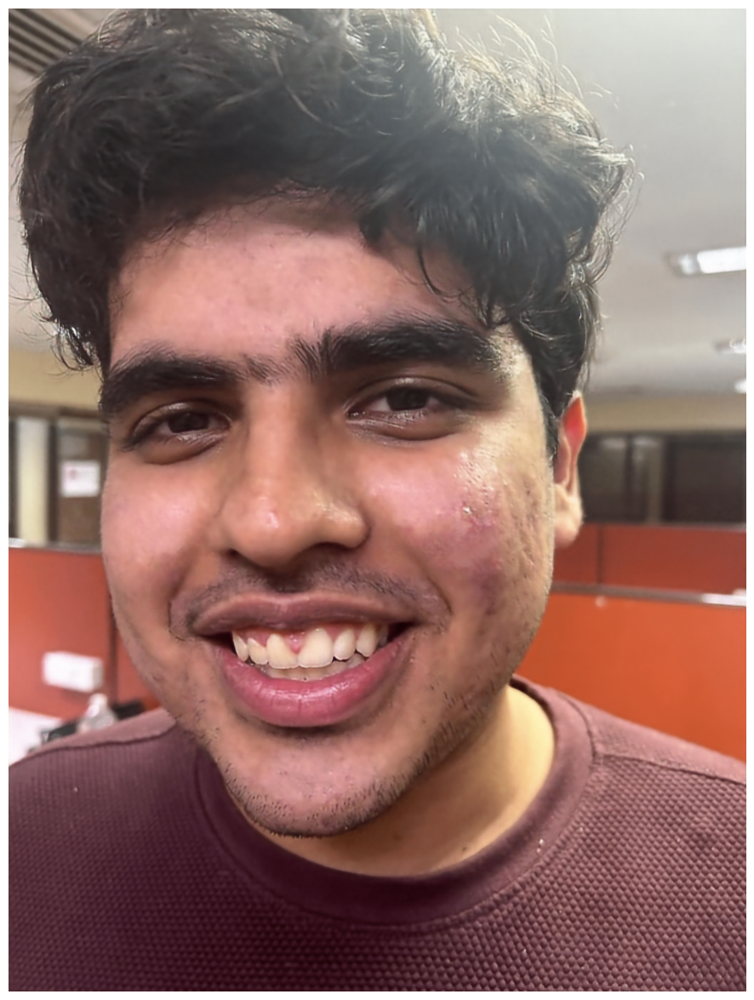

In [ ]:
imshow([kate_images[-1].detach().cpu().reshape(kate.shape)])
img_for_save = np.transpose(kate_images[-1].detach().cpu().reshape(kate.shape).numpy(), (1, 2, 0))*255
cv2.imwrite('prior.jpg', np.uint8(cv2.cvtColor(img_for_save, cv2.COLOR_RGB2BGR)))

Blends the inpainted regions from the neural network back into the original face, saving and displaying the final, seamlessly restored image.

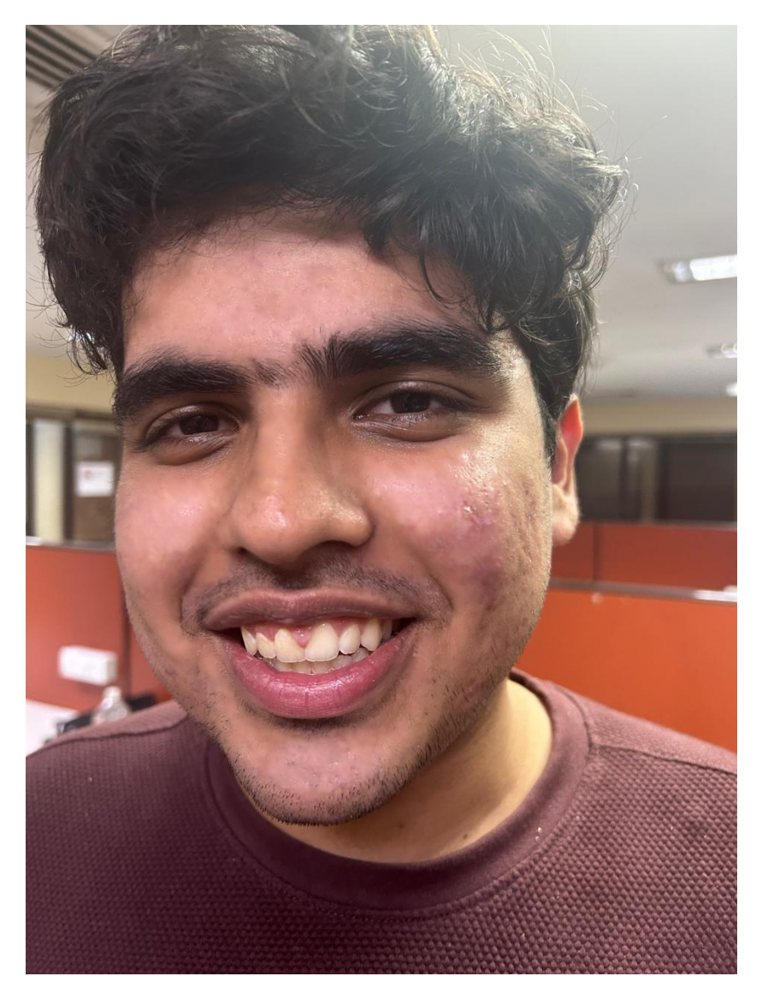

In [ ]:
new_img = crop_image(final_img/255) + img_for_save/255*crop_image((acne_mask==0)*1)[:, :, np.newaxis]
cv2.imwrite('final_prior.jpg', np.uint8(cv2.cvtColor(np.uint8(new_img*255), cv2.COLOR_RGB2BGR)))
cv2.imwrite('final_original.jpg', np.uint8(cv2.cvtColor(crop_image(imageRGB), cv2.COLOR_RGB2BGR)))
plot_img(new_img)